##### imports

In [ ]:
import pandas as pd
import numpy as np
import random
import pystan
import pymc3 as pm
import tensorflow as tf
import tensorflow_probability as tfp
import pickle
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
### setting of global random seeds
random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##### real data - manipulation

In [ ]:
Data = pd.read_csv('drive/MyDrive/Colab Notebooks/lab_rotation/data/Q_items_exp1_confirmatory_raw_col_rev.csv')

In [ ]:
Data

,cb100,cb101,cb103,cb105,cb107,cb108,cb12,cb13,cb17,cb18,cb19,cb20,cb25,cb28,cb3,cb35,cb4,cb44,cb45,cb46,cb47,cb49,cb52,cb55,cb57,cb6,cb63,cb68,cb73,cb74,cb75,cb76,cb79,cb80,cb81,cb84,cb89,cb9,cb92,cb96,...,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344
0,4.0,2.0,4.0,4.0,3.0,4.0,2.0,4.0,4.0,4.0,4.0,4.0,3.0,4.0,3.0,4.0,2.0,4.0,4.0,4.0,3.0,2.0,3.0,3.0,3.0,3.0,4.0,3.0,4.0,4.0,3.0,4.0,4.0,3.0,4.0,3.0,4.0,2.0,4.0,4.0,...,2.0,3.0,3.0,3.0,4.0,4.0,2.0,3.0,2.0,3.0,3.0,3.0,3.0,3.0,2.0,2.0,3.0,3.0,4.0,4.0,4.0,3.0,3.0,4.0,3.0,3.0,3.0,3.0,4.0,2.0,4.0,3.0,4.0,3.0,3.0,3.0,4.0,2.0,4.0,3.0
1,2.0,1.0,4.0,3.0,3.0,4.0,2.0,2.0,2.0,2.0,3.0,3.0,3.0,2.0,2.0,1.0,1.0,3.0,3.0,2.0,2.0,3.0,2.0,2.0,4.0,2.0,2.0,1.0,3.0,3.0,3.0,3.0,3.0,1.0,2.0,2.0,3.0,1.0,2.0,4.0,...,3.0,2.0,3.0,3.0,2.0,3.0,1.0,2.0,3.0,2.0,4.0,3.0,3.0,2.0,2.0,2.0,2.0,2.0,3.0,3.0,4.0,3.0,3.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0,3.0,2.0,2.0,2.0,3.0,3.0,1.0,2.0,4.0
2,4.0,1.0,3.0,4.0,3.0,3.0,1.0,3.0,3.0,4.0,4.0,3.0,3.0,4.0,2.0,3.0,1.0,4.0,3.0,4.0,2.0,2.0,3.0,3.0,2.0,3.0,3.0,2.0,3.0,4.0,2.0,4.0,3.0,2.0,3.0,3.0,4.0,1.0,4.0,3.0,...,1.0,3.0,3.0,2.0,3.0,3.0,1.0,2.0,3.0,2.0,3.0,2.0,3.0,2.0,1.0,1.0,3.0,1.0,3.0,4.0,4.0,2.0,3.0,4.0,2.0,3.0,3.0,2.0,3.0,2.0,2.0,3.0,3.0,2.0,3.0,4.0,4.0,1.0,3.0,3.0
3,3.0,1.0,4.0,4.0,2.0,4.0,1.0,2.0,4.0,2.0,3.0,3.0,2.0,2.0,1.0,4.0,2.0,3.0,3.0,4.0,2.0,2.0,3.0,3.0,2.0,2.0,2.0,2.0,3.0,4.0,2.0,3.0,3.0,1.0,3.0,2.0,3.0,1.0,2.0,4.0,...,1.0,2.0,2.0,3.0,2.0,4.0,1.0,3.0,2.0,3.0,3.0,2.0,3.0,1.0,1.0,1.0,2.0,3.0,3.0,4.0,1.0,2.0,3.0,3.0,3.0,3.0,3.0,1.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,4.0,3.0,1.0,2.0,4.0
4,3.0,1.0,3.0,3.0,3.0,3.0,1.0,2.0,3.0,2.0,3.0,2.0,2.0,2.0,1.0,2.0,1.0,2.0,3.0,2.0,2.0,1.0,2.0,2.0,2.0,3.0,2.0,2.0,3.0,2.0,2.0,2.0,1.0,1.0,1.0,2.0,3.0,1.0,2.0,2.0,...,2.0,2.0,2.0,3.0,2.0,3.0,1.0,1.0,2.0,1.0,2.0,2.0,2.0,2.0,1.0,1.0,1.0,2.0,1.0,2.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0,1.0,2.0,3.0,3.0,1.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,2.0,0.0,3.0,2.0,2.0,2.0,2.0,2.0,3.0,2.0,2.0,1.0,2.0,3.0,0.0,1.0,0.0,2.0,1.0,2.0,1.0,0.0,1.0,2.0,1.0,0.0,2.0,0.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,2.0,0.0,2.0,2.0,...,0.0,1.0,0.0,1.0,NaN,1.0,0.0,1.0,1.0,1.0,1.0,3.0,3.0,1.0,0.0,0.0,0.0,0.0,2.0,1.0,3.0,0.0,1.0,2.0,3.0,1.0,1.0,0.0,3.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
124,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,0.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,...,1.0,0.0,0.0,2.0,NaN,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
125,2.0,0.0,3.0,1.0,3.0,2.0,0.0,1.0,2.0,1.0,2.0,2.0,3.0,0.0,0.0,0.0,0.0,1.0,2.0,2.0,1.0,0.0,2.0,1.0,1.0,1.0,1.0,0.0,2.0,2.0,2.0,0.0,1.0,0.0,1.0,2.0,2.0,0.0,1.0,1.0,...,0.0,0.0,0.0,2.0,NaN,1.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,1.0,0.0,0.0,0.0,1.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0
126,0.0,0.0,3.0,2.0,1.0,2.0,0.0,1.0,0.0,2.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,0.0,0.0,2.0,1.0,2.0,0.0,0.0,0.0,1.0,1.0,2.0,0.0,1.0,0.0,0.0,1.0,2.0,0.0,2.0,0.0,...,0.0,1.0,0.0,2.0,NaN,2.0,0.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,2.0,0.0,1.0


In [ ]:
questions = pd.read_csv('drive/MyDrive/Colab Notebooks/lab_rotation/data/Q_labels_exp1.csv')

In [ ]:
questions

,Question,Questionnaire,Subscale,Min,Max,Rev
0,I feel pleasant,STAI,anxiety,2.0,4.0,1.0
1,I feel nervous and restless,STAI,anxiety,1.0,4.0,NaN
2,I feel satisfied with myself,STAI,depression,1.0,4.0,1.0
3,I wish I could be as happy as others seem to be,STAI,depression,1.0,4.0,NaN
4,I feel like a failure,STAI,depression,1.0,3.0,NaN
...,...,...,...,...,...,...
123,I enjoyed life.,CESD,cesd,0.0,3.0,1.0
124,I had crying spells.,CESD,cesd,0.0,2.0,NaN
125,I felt sad.,CESD,cesd,0.0,3.0,NaN
126,I felt that people dislike me.,CESD,cesd,0.0,3.0,NaN


In [ ]:
 questions[questions['Questionnaire']=='MASQ'].shape

(39, 6)

In [ ]:
ix_masq = questions[questions['Questionnaire']=='MASQ'].index.values
ix_masq

array([48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64,
       65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81,
       82, 83, 84, 85, 86])

In [ ]:
ix_masq.shape

(39,)

In [ ]:
ix_anhedonic = np.where((questions['Questionnaire']=='MASQ') & 
                        (questions['Subscale'] == 'anhedonic'))

In [ ]:
ix_anx = np.where((questions['Questionnaire']=='MASQ') & 
                        (questions['Subscale'] != 'anhedonic'))

In [ ]:
ix_anx

(array([48, 50, 53, 55, 57, 59, 62, 63, 65, 67, 69, 71, 72, 74, 77, 78, 80,
        86]),)

In [ ]:
ix_anhedonic

(array([49, 51, 52, 54, 56, 58, 60, 61, 64, 66, 68, 70, 73, 75, 76, 79, 81,
        82, 83, 84, 85]),)

In [ ]:
ix_anhedonic[0][0]

49

In [ ]:
ix_masq_sorted = np.append(ix_anx, ix_anhedonic)

In [ ]:
ix_masq_sorted

array([48, 50, 53, 55, 57, 59, 62, 63, 65, 67, 69, 71, 72, 74, 77, 78, 80,
       86, 49, 51, 52, 54, 56, 58, 60, 61, 64, 66, 68, 70, 73, 75, 76, 79,
       81, 82, 83, 84, 85])

In [ ]:
ix_masq_sorted[np.where(ix_masq_sorted == ix_anhedonic[0][0])], ix_masq_sorted[1] = ix_masq_sorted[1], ix_masq_sorted[np.where(ix_masq_sorted == ix_anhedonic[0][0])]

In [ ]:
ix_masq_sorted

array([48, 49, 53, 55, 57, 59, 62, 63, 65, 67, 69, 71, 72, 74, 77, 78, 80,
       86, 50, 51, 52, 54, 56, 58, 60, 61, 64, 66, 68, 70, 73, 75, 76, 79,
       81, 82, 83, 84, 85])

##### drop of columns with NaN values

In [ ]:
Data_ = Data.dropna(axis = 1)

In [ ]:
Data_.shape

(128, 280)

##### sort dataframe with AA first and AD second

In [ ]:
Data_masq = Data_.iloc[ix_masq, :]

In [ ]:
Data_masq_sorted = Data_masq.reindex(ix_masq_sorted)

##### generation of data for the model

In [ ]:
Y = Data_masq.values
Y_sorted = Data_masq_sorted.values
Y = Y.T
Y.shape

(280, 39)

##### data exploration

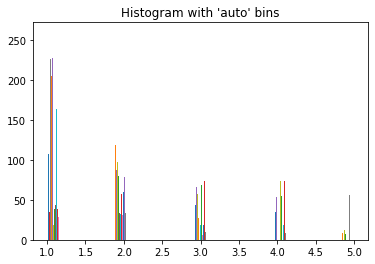

In [ ]:
plt.hist(Y, bins='auto')  # arguments are passed to np.histogram
plt.title("Histogram with 'auto' bins")
# Text(0.5, 1.0, "Histogram with 'auto' bins")
plt.show()

##### correlation matrix of items

In [ ]:
Y_sorted

array([[1., 1., 3., ..., 4., 3., 1.],
       [4., 1., 5., ..., 3., 2., 3.],
       [1., 1., 3., ..., 1., 1., 1.],
       ...,
       [3., 1., 5., ..., 1., 3., 4.],
       [4., 1., 5., ..., 1., 3., 4.],
       [3., 1., 3., ..., 1., 1., 1.]])

In [ ]:
C_Y_sorted = np.corrcoef(Y_sorted) # Y transpose, because the rows are the variables 

In [ ]:
C_Y_sorted.min()

-0.08944424284958807

In [ ]:
C_Y_sorted.shape

(39, 39)

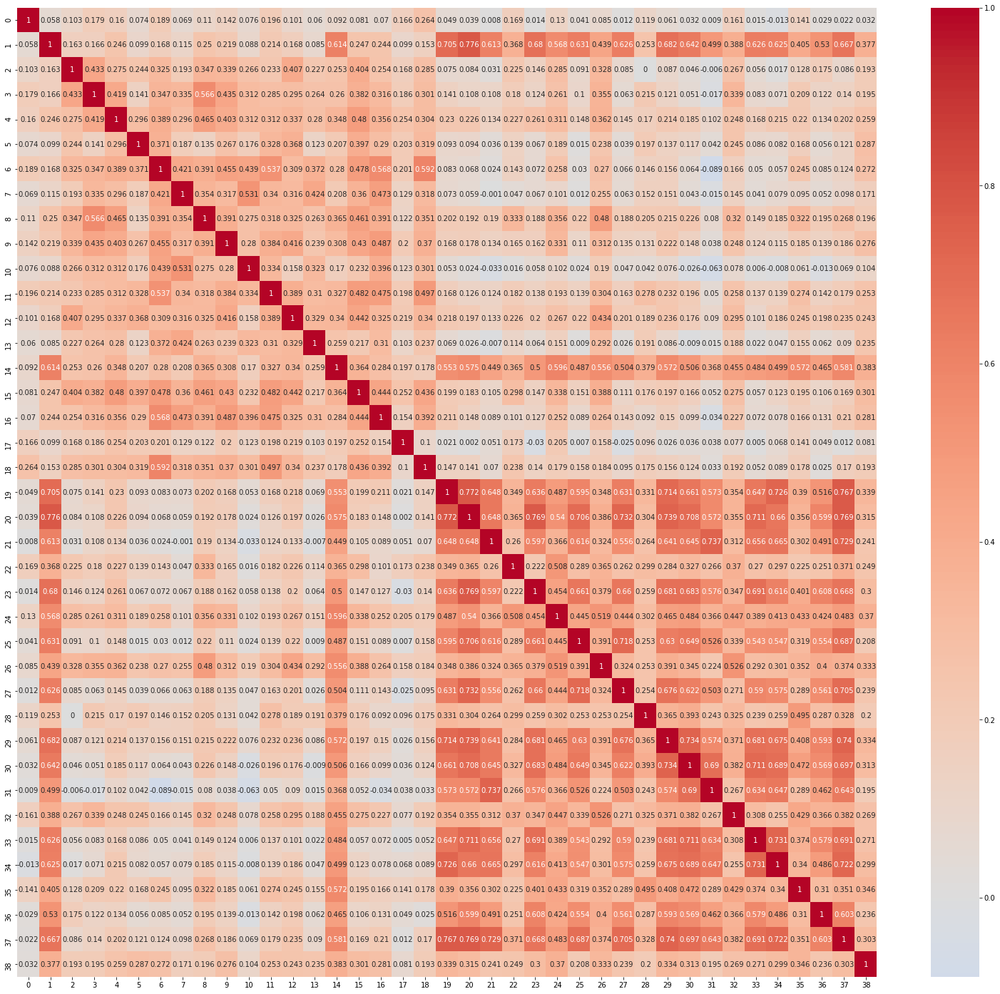

In [ ]:
plt.figure(figsize=(27,25))
sns.heatmap(np.round(C_Y_sorted,3), annot = True, fmt='g', cmap='coolwarm', center = 0)
plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/True_Cor.png', bbox_inches='tight')

##### covariance matrix of sorted items

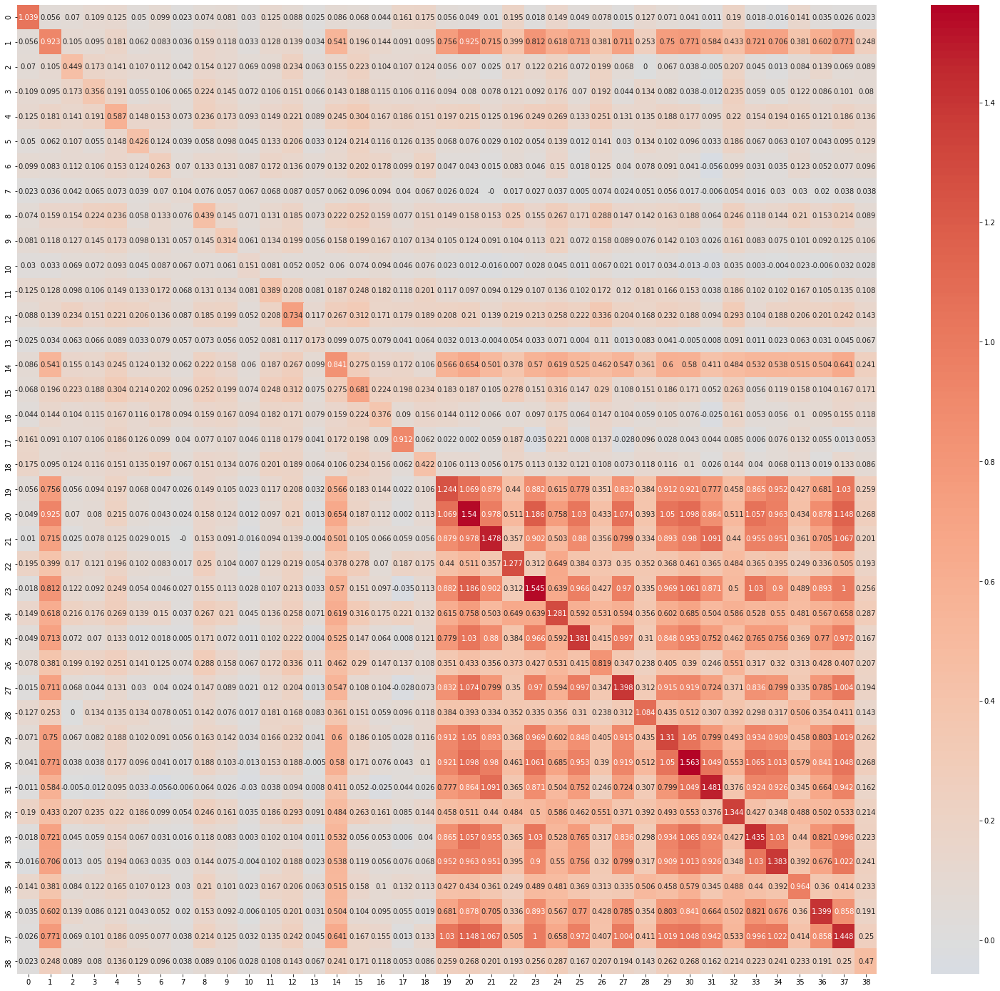

In [ ]:
# np.set_printoptions(suppress=True)
cov_Y_sorted = np.cov(Y_sorted)#,rowvar = False)
plt.figure(figsize=(27,25))
sns.heatmap(np.round(cov_Y_sorted, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
# plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/True_Cov.png', bbox_inches='tight')

##### drop possible nans 

In [ ]:
Y_sorted = Y_sorted.T

In [ ]:
# drop possible NaNs
mask = np.any(np.isnan(Y_sorted), axis=1)
Y_sorted = Y_sorted[~mask]
Y_sorted.shape

(280, 39)

##### Mean of the data

In [ ]:
mu = np.mean(Y_sorted, axis = 0)
mu.shape

(39,)

In [ ]:
print(mu.max(), mu.min())

3.3214285714285716 1.1035714285714286


##### dimensions of stan data

In [ ]:
Y_sorted.shape

(280, 39)

In [ ]:
N, P = Y_sorted.shape
D = 3 #all latent dimensions
G = 1 #primary latent dimension
F = D - G #secondary latent dimensions

In [ ]:
M = int(F*(P-F))#+ F*(F-1)/2)
M

74

##### save the dataframe

In [ ]:
Y_sorted_df = pd.DataFrame(Y_sorted)

In [ ]:
Y_sorted_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38
0,1.0,4.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.0,2.0,1.0,1.0,1.0,5.0,5.0,5.0,3.0,4.0,4.0,4.0,1.0,4.0,4.0,4.0,5.0,5.0,3.0,5.0,5.0,4.0,3.0,4.0,3.0
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,4.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,3.0,5.0,3.0,3.0,4.0,3.0,3.0,1.0,3.0,3.0,1.0,3.0,4.0,1.0,4.0,4.0,3.0,1.0,3.0,5.0,5.0,5.0,3.0,5.0,4.0,4.0,2.0,3.0,3.0,5.0,5.0,3.0,5.0,5.0,5.0,3.0,5.0,5.0,3.0
3,2.0,4.0,2.0,1.0,2.0,3.0,1.0,2.0,1.0,2.0,1.0,2.0,3.0,1.0,4.0,3.0,2.0,3.0,1.0,5.0,5.0,4.0,2.0,4.0,4.0,4.0,4.0,5.0,4.0,4.0,5.0,5.0,5.0,4.0,5.0,2.0,4.0,5.0,3.0
4,1.0,3.0,3.0,3.0,1.0,1.0,1.0,1.0,3.0,2.0,1.0,2.0,2.0,1.0,4.0,4.0,2.0,1.0,2.0,5.0,4.0,5.0,2.0,5.0,4.0,5.0,4.0,4.0,2.0,5.0,5.0,5.0,5.0,4.0,4.0,4.0,5.0,5.0,1.0


In [ ]:
# Y_sorted_df.to_csv("drive/MyDrive/Colab Notebooks/lab_rotation/data/real/Y_sorted_df.csv", 
#             header = False, index = False)

##### Stan Model

In [ ]:
model = """
data
{
  int<lower=1> N; // sample size
  int<lower=1> P; // number of individuals
  matrix[N,P] Y; // data matrix of order [N,P]
  vector[P] mu; // P-dimensional mean of the data
  int<lower=1> F; // number of factors  
}

transformed data
{
  int<lower=1> M;
  M = F*(P-F); // number of lower-triangular, non-zero loadings
}
parameters
{
  //Parameters
  vector<lower=0>[M] L_lower; //Lower diagonal loadings - FORCED TO BE POSITIVE
  vector<lower=0>[F] L_diag; //Positive diagonal elements of loadings
  vector<lower=0>[P] L_G; // loadings of G factor 
  //Hyperparameters
  vector<lower=0>[P] psi;         // vector of variances
  real<lower=0>   mu_psi;
  real<lower=0>  sigma_psi;
  real mu_low; //Mean of lower diag loadings
  real<lower=0> sigma_low; //Scale of lower diag loadings
  real mu_G; //Mean of G-factor loadings
  real<lower=0> sigma_G; //Scale of G-factor loadings
}

transformed parameters
{
  cholesky_factor_cov[P,F] L; //Final matrix of laodings
  cov_matrix[P] Q;   //Covariance mat
  //Predictors
  {
    int idx2; //Index for the lower diagonal loadings
    idx2 = 0;
    // Constraints to allow identifiability of loadings
    for(i in 1:(F-1)) { for(j in (i+1):(F)){ L[i,j] = 0; } } //0 on upper diagonal
    for(j in 1:(F-1)) { for(i in (j+1):F){ L[i,j] = 0; } } //0 on lower diagonal
    for(i in 1:F) L[i,i] = L_diag[i]; //Positive values on diagonal
    for(j in 1:F) 
    {
      for(i in (F+1):P) 
      {
        idx2 = idx2+1;
        L[i,j] = L_lower[idx2]; //Insert lower diagonal values in loadings matrix
      }
    }
  }
  Q = L_G*L_G' + multiply_lower_tri_self_transpose(L) + diag_matrix(psi);
}

model
{
  // Hyperpriors
  mu_psi ~ cauchy(0, 1);
  sigma_psi ~ cauchy(0,1);
  mu_low ~ cauchy(0,1); //Mu of lower diag loadings
  sigma_low ~ cauchy(0,1); //Scales of the lower diag loadings
  mu_G ~ cauchy(0,1); //Mu of G-factor loadings
  sigma_G ~ cauchy(0,1); //Scales of the G-factor loadings
  // Priors
  L_diag ~ cauchy(0,2.5); //Weakly informative prior for diagonal loadings
  L_lower ~ cauchy(mu_low, sigma_low); //Hierarchical prior for lower diag loadings
  L_G ~ cauchy(0,2.5); //Hierarchical prior for G loadings
  psi ~ cauchy(mu_psi,sigma_psi);
  // The Likelihood
  for(i in 1:N) Y[i] ~ multi_normal(mu, Q);
}
generated quantities
{
  matrix[P,P] cov_L;
  matrix[P,P] cor_L;
  cov_L = Q; //Create the covariance matrix
  // Compute the correlation matrix from the covariance matrix
  for(i in 1:P)
  {
    for(j in 1:P)
    {
      cor_L[i,j] = cov_L[i,j]/sqrt(cov_L[i,i]*cov_L[j,j]);
    }
  }
}
"""

##### Fitting of the model

In [ ]:
# Put our data in a dictionary
data = {'Y' : Y_sorted, 'mu' : mu, 'N': N, 'P': P, 'F': F}

# Compile the model
sm = pystan.StanModel(model_code=model)

INFO:pystan:COMPILING THE C++ CODE FOR MODEL anon_model_bfa16ffc309a6a8f19c899be23aff2bd NOW.


In [ ]:
def init_fun():
  init_values = {'L_lower' : np.full(M, 0.5) +
                 np.full(M, np.random.uniform(-.1, .1)),
                 'L_diag' : np.full(F, 0.5) +
                 np.full(F, np.random.uniform(-.1, .1)),
                 'L_G' : np.full(P, 0.5) +
                 np.full(P, np.random.uniform(-.1, .1)),
                 'psi' : np.full(P, 0.2) +
                 np.full(P, np.random.uniform(-.1, .1)),
                 'sigma_psi' : 0.15 + np.random.uniform(-.1, .1),
                 'mu_psi' :0.2 + np.random.uniform(-.1, .1),
                 'sigma_low' : 0.5 + np.random.uniform(-.1, .1),
                 'mu_low' : 0.0 + np.random.uniform(-.1, .1),
                 'mu_G' : 0.0 + np.random.uniform(-.1, .1),
                 'sigma_G' : 0.5 + np.random.uniform(-.1, .1)}
  return init_values

In [ ]:
# Train the model and generate samples
Nchains = 4
Niter = 600
control = {}
control['max_treedepth'] = 20
control['adapt_delta'] = 0.95 ## to increase adapt_delta according to warning
fit = sm.sampling(data=data,
                  pars= ("L", "L_G", "psi","sigma_psi",
                         "mu_psi","sigma_low","mu_low", "cov_L", "cor_L"),
                  iter=Niter,
                  chains=Nchains,
                  init = init_fun,
                  warmup=300,
                  thin=1,
                  seed=42)

To run all diagnostics call pystan.check_hmc_diagnostics(fit)


In [ ]:
pystan.check_hmc_diagnostics(fit)

{'Rhat': False,
 'divergence': True,
 'energy': True,
 'n_eff': False,
 'treedepth': True}

##### results

In [ ]:
summary_dict = fit.summary()
df = pd.DataFrame(summary_dict['summary'], 
                  columns=summary_dict['summary_colnames'], 
                  index=summary_dict['summary_rownames'])

In [ ]:
df

,mean,se_mean,sd,2.5%,25%,50%,75%,97.5%,n_eff,Rhat
"L[1,1]",0.143445,0.002690,0.066893,0.022173,0.098806,0.144071,0.186262,0.280789,618.591456,1.001414
"L[2,1]",0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN
"L[3,1]",0.171445,0.002808,0.045505,0.078641,0.141785,0.171952,0.200092,0.264385,262.690599,1.001379
"L[4,1]",0.199945,0.002817,0.044331,0.116497,0.170252,0.198178,0.229655,0.288432,247.585843,1.004220
"L[5,1]",0.293368,0.003156,0.055400,0.189090,0.254747,0.290556,0.332187,0.398708,308.178147,1.003561
...,...,...,...,...,...,...,...,...,...,...
"cor_L[36,39]",0.301378,0.001286,0.040072,0.224675,0.272884,0.301031,0.328207,0.378524,971.617607,0.999682
"cor_L[37,39]",0.295969,0.001391,0.040711,0.214783,0.269420,0.296233,0.321907,0.376521,857.087896,1.003488
"cor_L[38,39]",0.350501,0.001592,0.045936,0.254039,0.321947,0.350133,0.379801,0.440343,833.042159,1.004281
"cor_L[39,39]",1.000000,NaN,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN


In [ ]:
df['n_eff'].min()

136.47701999244836

##### Mean of the estimated Loadings 

In [ ]:
L_mean_estim = np.zeros(F*P)
for i,j in enumerate(df.index.values[:F*P]):
  L_mean_estim[i] = df['mean'][j]

In [ ]:
np.set_printoptions(suppress=True) # it suppresses the scientific notation 
L_mean_estim = np.reshape(L_mean_estim, (P, F), order = 'F')
L_mean_estim

array([[0.14344537, 0.        ],
       [0.        , 0.71318441],
       [0.17144518, 0.03781832],
       [0.19994548, 0.04330391],
       [0.29336811, 0.13112463],
       [0.22168683, 0.05740647],
       [0.36643988, 0.03852693],
       [0.19037047, 0.02544345],
       [0.22993909, 0.11092258],
       [0.26363592, 0.07991283],
       [0.21300348, 0.02202317],
       [0.36547179, 0.10323131],
       [0.28706854, 0.13435784],
       [0.16434546, 0.0244442 ],
       [0.14552199, 0.50010611],
       [0.37907054, 0.09701166],
       [0.38676305, 0.08610891],
       [0.14849695, 0.04886617],
       [0.38963911, 0.08645251],
       [0.13707849, 0.90768039],
       [0.08208999, 1.06640714],
       [0.09344913, 0.95522431],
       [0.0677306 , 0.31223834],
       [0.11211295, 0.98661641],
       [0.07707609, 0.51407499],
       [0.06131081, 0.872093  ],
       [0.12261515, 0.2791778 ],
       [0.11095532, 0.90771244],
       [0.1212485 , 0.30806063],
       [0.18968573, 0.94486341],
       [0.

In [ ]:
# Dataframe of the mean of the estimated Loadings
L_mean_estim_df = pd.DataFrame(np.round(L_mean_estim, 3),
                               columns = [r'$\widehat{\vect{W_1}}$',
                                          r'$\widehat{\vect{W_2}}$'])

G-loadings

In [ ]:
L_G_mean_estim = np.zeros(P)
for i,j in enumerate(df.index.values[F*P:(F*P+P)]):
  L_G_mean_estim[i] = df['mean'][j]

In [ ]:
L_G_mean_estim = L_G_mean_estim[:, np.newaxis]
L_G_mean_estim

array([[0.20860322],
       [0.36551097],
       [0.34303192],
       [0.31688611],
       [0.36633538],
       [0.21065267],
       [0.18945847],
       [0.07590051],
       [0.38198184],
       [0.25109206],
       [0.07165363],
       [0.22145613],
       [0.42166124],
       [0.13331319],
       [0.55794532],
       [0.46178386],
       [0.20519674],
       [0.29882801],
       [0.17923764],
       [0.26046334],
       [0.32695001],
       [0.1412352 ],
       [0.57065454],
       [0.28402705],
       [0.74379771],
       [0.28636541],
       [0.64414815],
       [0.20755561],
       [0.35771487],
       [0.26687047],
       [0.27697756],
       [0.07534105],
       [0.69746213],
       [0.12750056],
       [0.14138834],
       [0.47568318],
       [0.3282593 ],
       [0.25828404],
       [0.26796689]])

In [ ]:
# Dataframe of the mean of the estimated G-Loadings
L_G_mean_estim_df = pd.DataFrame(np.round(L_G_mean_estim, 3),
                               columns = [r'$\widehat{\vect{W_G}}$'])

##### Psi estimations

In [ ]:
Psi_mean_estim = np.zeros(P)
for i,j in enumerate(df.index.values[df.index.get_loc("psi[1]"):df.index.get_loc("psi[10]")+1]):
  Psi_mean_estim[i] = df['mean'][j]

In [ ]:
Psi_mean_estim.shape

(39,)

In [ ]:
Psi_mean_estim_df = pd.DataFrame(np.round(Psi_mean_estim,3),
                                 columns = [r'$\widehat{\vect{\Psi}}$'])

##### estimated mean of L loadings matrix

In [ ]:
L_F_mean_estim = np.zeros(int(F*P))
for i,j in enumerate(df.index.values[:int(F*P)]):
  L_F_mean_estim[i] = df['mean'][j]

In [ ]:
L_F_mean_estim = np.reshape(L_F_mean_estim, (P, F), order = 'F')
L_F_mean_estim

array([[ 0.02546986,  0.        ],
       [ 0.        ,  0.07709048],
       [-0.17353806, -0.24516338],
       [-0.19311105, -0.23653305],
       [-0.25867873, -0.25692886],
       [-0.18918724, -0.18611969],
       [-0.28970359, -0.2337514 ],
       [-0.15202919, -0.1085747 ],
       [-0.21841849, -0.25580866],
       [-0.22521106, -0.21024848],
       [-0.16842113, -0.12020801],
       [-0.28944549, -0.22220227],
       [-0.26454728, -0.28508983],
       [-0.1415503 , -0.13661038],
       [-0.16345649, -0.1774223 ],
       [-0.33207332, -0.3634389 ],
       [-0.31071621, -0.23076777],
       [-0.14872426, -0.20791524],
       [-0.29921784, -0.22004699],
       [-0.1039631 ,  0.14558687],
       [-0.0598696 ,  0.18748609],
       [-0.04932715,  0.25873433],
       [-0.07728277, -0.1917861 ],
       [-0.08190177,  0.16795804],
       [-0.11908535, -0.23907524],
       [-0.03710905,  0.14876456],
       [-0.17060378, -0.29075389],
       [-0.06951332,  0.17954492],
       [-0.12270667,

In [ ]:
L_F_df = pd.DataFrame(L_F_mean_estim,
                 columns=['L_F[:,1]', 'L_F[:,2]'])

In [ ]:
L_G_mean_estim = np.zeros(P)
for i,j in enumerate(df.index.values[F*P:(F*P+P)]):
  L_G_mean_estim[i] = df['mean'][j]

In [ ]:
L_G_mean_estim = L_G_mean_estim[:, np.newaxis]
L_G_mean_estim

array([[0.09871214],
       [0.82324615],
       [0.14443016],
       [0.14450487],
       [0.25442086],
       [0.11042842],
       [0.08168637],
       [0.03851581],
       [0.24617479],
       [0.15487277],
       [0.02918549],
       [0.15774327],
       [0.28242058],
       [0.05429044],
       [0.70421837],
       [0.25152023],
       [0.13159529],
       [0.10925565],
       [0.12129023],
       [0.94488978],
       [1.1224043 ],
       [0.9335882 ],
       [0.55793471],
       [1.0288471 ],
       [0.80604863],
       [0.92997641],
       [0.53986782],
       [0.92313983],
       [0.45356993],
       [0.97794869],
       [1.05980733],
       [0.85282644],
       [0.64618145],
       [0.94911026],
       [0.92502977],
       [0.54696556],
       [0.84807998],
       [1.0574741 ],
       [0.29841328]])

In [ ]:
L_G_df = pd.DataFrame(L_G_mean_estim,
                 columns=['L_G[:,1]'])

##### Psi mean estimated

In [ ]:
df.index.values[(F*P+P)]

'psi[1]'

In [ ]:
Psi_mean_estim = np.zeros(P)
for i,j in enumerate(df.index.values[(F*P+P):(F*P+2*P)]):
  Psi_mean_estim[i] = df['mean'][j]

In [ ]:
Psi_mean_estim

array([1.03021267, 0.32328052, 0.32969709, 0.23812121, 0.38660523,
       0.34772027, 0.10797952, 0.06646465, 0.26651123, 0.19719016,
       0.10483962, 0.22606318, 0.48509711, 0.13586102, 0.34396107,
       0.36734782, 0.19818239, 0.81505854, 0.26036632, 0.38244609,
       0.34644023, 0.55040732, 0.90098958, 0.52198064, 0.56146102,
       0.55612785, 0.39238385, 0.54553206, 0.86455009, 0.37709545,
       0.47337181, 0.64899528, 0.79996027, 0.46722055, 0.46988793,
       0.63872858, 0.7313709 , 0.34180706, 0.36536367])

In [ ]:
Psi_mean_estim_diag = np.diagflat(Psi_mean_estim)

In [ ]:
Psi_mean_estim_diag.shape

(39, 39)

##### dataframe

In [ ]:
masq_df = questions[questions['Questionnaire']=='MASQ']
masq_df = masq_df.reindex(ix_masq_sorted)
masq_df.set_index(np.arange(P), inplace=True)

In [ ]:
print(masq_df.drop(columns = 'Rev').to_latex(escape=False))

\begin{tabular}{llllrr}
\toprule
{} &                                           Question & Questionnaire &         Subscale &  Min &  Max \\
\midrule
0  &                                    Startled easily &          MASQ &  anxious arousal &  1.0 &  4.0 \\
1  &                                      Felt cheerful &          MASQ &        anhedonic &  1.0 &  5.0 \\
2  &                                Was short of breath &          MASQ &  anxious arousal &  1.0 &  3.0 \\
3  &                                         Felt faint &          MASQ &  anxious arousal &  1.0 &  3.0 \\
4  &                             Had hot or cold spells &          MASQ &  anxious arousal &  1.0 &  4.0 \\
5  &                          Hands were cold or sweaty &          MASQ &  anxious arousal &  1.0 &  3.0 \\
6  &                           Was trembling or shaking &          MASQ &  anxious arousal &  1.0 &  3.0 \\
7  &                             Had trouble swallowing &          MASQ &  anxious arousal &  

In [ ]:
L_full_df = pd.concat([masq_df, L_G_mean_estim_df, L_mean_estim_df, Psi_mean_estim_df], axis = 1)
L_full_df

,Question,Questionnaire,Subscale,Min,Max,Rev,$\widehat{\vect{W_G}}$,$\widehat{\vect{W_1}}$,$\widehat{\vect{W_2}}$,$\widehat{\vect{\Psi}}$
0,Startled easily,MASQ,anxious arousal,1.0,4.0,NaN,0.209,0.143,0.000,0.975
1,Felt cheerful,MASQ,anhedonic,1.0,5.0,1.0,0.366,0.000,0.713,0.319
2,Was short of breath,MASQ,anxious arousal,1.0,3.0,NaN,0.343,0.171,0.038,0.331
3,Felt faint,MASQ,anxious arousal,1.0,3.0,NaN,0.317,0.200,0.043,0.238
4,Had hot or cold spells,MASQ,anxious arousal,1.0,4.0,NaN,0.366,0.293,0.131,0.386
5,Hands were cold or sweaty,MASQ,anxious arousal,1.0,3.0,NaN,0.211,0.222,0.057,0.348
6,Was trembling or shaking,MASQ,anxious arousal,1.0,3.0,NaN,0.189,0.366,0.039,0.106
7,Had trouble swallowing,MASQ,anxious arousal,1.0,2.0,NaN,0.076,0.190,0.025,0.067
8,Felt dizzy or lightheaded,MASQ,anxious arousal,1.0,3.0,NaN,0.382,0.230,0.111,0.266
9,Had pain in my chest,MASQ,anxious arousal,1.0,3.0,NaN,0.251,0.264,0.080,0.197


In [ ]:
L_full_df = L_full_df.reset_index()

In [ ]:
# drop not necessary columns for the report
L_full_df = L_full_df.drop(columns = ['index', 'Questionnaire', 'Min', 'Max', 'Rev'])

In [ ]:
L_full_df

,Question,Subscale,$\widehat{\vect{W_G}}$,$\widehat{\vect{W_1}}$,$\widehat{\vect{W_2}}$,$\widehat{\vect{\Psi}}$
0,Startled easily,anxious arousal,0.209,0.143,0.000,0.975
1,Felt cheerful,anhedonic,0.366,0.000,0.713,0.319
2,Was short of breath,anxious arousal,0.343,0.171,0.038,0.331
3,Felt faint,anxious arousal,0.317,0.200,0.043,0.238
4,Had hot or cold spells,anxious arousal,0.366,0.293,0.131,0.386
5,Hands were cold or sweaty,anxious arousal,0.211,0.222,0.057,0.348
6,Was trembling or shaking,anxious arousal,0.189,0.366,0.039,0.106
7,Had trouble swallowing,anxious arousal,0.076,0.190,0.025,0.067
8,Felt dizzy or lightheaded,anxious arousal,0.382,0.230,0.111,0.266
9,Had pain in my chest,anxious arousal,0.251,0.264,0.080,0.197


##### import omega results from r notebook 

In [ ]:
omega = pd.read_csv('drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/omega_est_MASQ_df.csv',
                    names = [r'$\omega\widehat{\vect{W_G}}$', r'$\omega\widehat{\vect{W_2}}$', r'$\omega\widehat{\vect{W_1}}$', r'$foo$', r'$\omega\widehat{\vect{Psi}}$'])

In [ ]:
omega.head()

,$\omega\widehat{\vect{W_G}}$,$\omega\widehat{\vect{W_2}}$,$\omega\widehat{\vect{W_1}}$,$foo$,$\omega\widehat{\vect{Psi}}$
0,g,F1*,F2*,h2,u2
1,0.113002184928682,-0.0141874476231841,0.198646709437263,0.0524312926389689,0.947568707361031
2,0.465401393883114,0.660129455005105,0.0995691084970311,0.662283362160576,0.337716637839424
3,0.257993947199962,-0.0242636190516702,0.445400370372364,0.265531089929141,0.734468910070859
4,0.300931466350324,-0.0200284116012713,0.511254277496186,0.352341820969173,0.647658179030827


In [ ]:
omega_ = omega.drop(index = 0, columns = '$foo$')

In [ ]:
omega_ = omega_.astype(float).round(3)

In [ ]:
omega_ = omega_.reset_index()

In [ ]:
omega_ = omega_.drop(columns = 'index')

In [ ]:
columns_titles = [r'$\omega\widehat{\vect{W_G}}$', r'$\omega\widehat{\vect{W_1}}$', r'$\omega\widehat{\vect{W_2}}$', r'$\omega\widehat{\vect{Psi}}$']
omega_ = omega_.reindex(columns=columns_titles)

In [ ]:
omega_.head()

,$\omega\widehat{\vect{W_G}}$,$\omega\widehat{\vect{W_1}}$,$\omega\widehat{\vect{W_2}}$,$\omega\widehat{\vect{Psi}}$
0,0.113,0.199,-0.014,0.948
1,0.465,0.100,0.660,0.338
2,0.258,0.445,-0.024,0.734
3,0.301,0.511,-0.020,0.648
4,0.345,0.492,0.071,0.634


In [ ]:
# save the dataframe in .csv file
omega_.to_csv("drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/omega_final_masq_df.csv", 
            header = False, index = False)

##### reconstruct covariance matrix from the omega results

In [ ]:
omega_array = omega_.to_numpy()

In [ ]:
# C = W_F*W_F.T + w_G*w_G.T + \Psi
omega_cov_L = omega_array[:, 1:3]@omega_array[:, 1:3].T + omega_array[:, 0][:,np.newaxis]@omega_array[:, 0][:,np.newaxis].T + np.diag(omega_array[:,-1])

In [ ]:
omega_cov_L.shape

(39, 39)

##### reported dataframes

In [ ]:
# drop questions column for sake of space
L_full_df = L_full_df.drop(columns = ['Question'])

In [ ]:
print(L_full_df.to_latex(escape=False))

\begin{tabular}{llrrrr}
\toprule
{} &         Subscale &  $\widehat{\vect{W_G}}$ &  $\widehat{\vect{W_1}}$ &  $\widehat{\vect{W_2}}$ &  $\widehat{\vect{\Psi}}$ \\
\midrule
0  &  anxious arousal &                   0.209 &                   0.143 &                   0.000 &                    0.975 \\
1  &        anhedonic &                   0.366 &                   0.000 &                   0.713 &                    0.319 \\
2  &  anxious arousal &                   0.343 &                   0.171 &                   0.038 &                    0.331 \\
3  &  anxious arousal &                   0.317 &                   0.200 &                   0.043 &                    0.238 \\
4  &  anxious arousal &                   0.366 &                   0.293 &                   0.131 &                    0.386 \\
5  &  anxious arousal &                   0.211 &                   0.222 &                   0.057 &                    0.348 \\
6  &  anxious arousal &                   0.189 

In [ ]:
omega_masq_df = pd.concat([masq_df, omega_], axis = 1)
omega_masq_df = omega_masq_df.drop(columns = ['Question', 'Questionnaire', 'Min', 'Max', 'Rev'])
print(omega_masq_df.to_latex(escape=False))

\begin{tabular}{llrrrr}
\toprule
{} &         Subscale &  $\omega\widehat{\vect{W_G}}$ &  $\omega\widehat{\vect{W_1}}$ &  $\omega\widehat{\vect{W_2}}$ &  $\omega\widehat{\vect{Psi}}$ \\
\midrule
0  &  anxious arousal &                         0.113 &                         0.199 &                        -0.014 &                         0.948 \\
1  &        anhedonic &                         0.465 &                         0.100 &                         0.660 &                         0.338 \\
2  &  anxious arousal &                         0.258 &                         0.445 &                        -0.024 &                         0.734 \\
3  &  anxious arousal &                         0.301 &                         0.511 &                        -0.020 &                         0.648 \\
4  &  anxious arousal &                         0.345 &                         0.492 &                         0.071 &                         0.634 \\
5  &  anxious arousal &                 

##### generation of cov matrix

In [ ]:
cov_L = np.zeros(P*P)
for i,j in enumerate(df.index.values[df.index.get_loc("cov_L[1,1]"):df.index.get_loc("cov_L[39,39]")+1]):
  cov_L[i] = df['mean'][j]
cov_L = np.reshape(cov_L, (P, P), order = 'F')

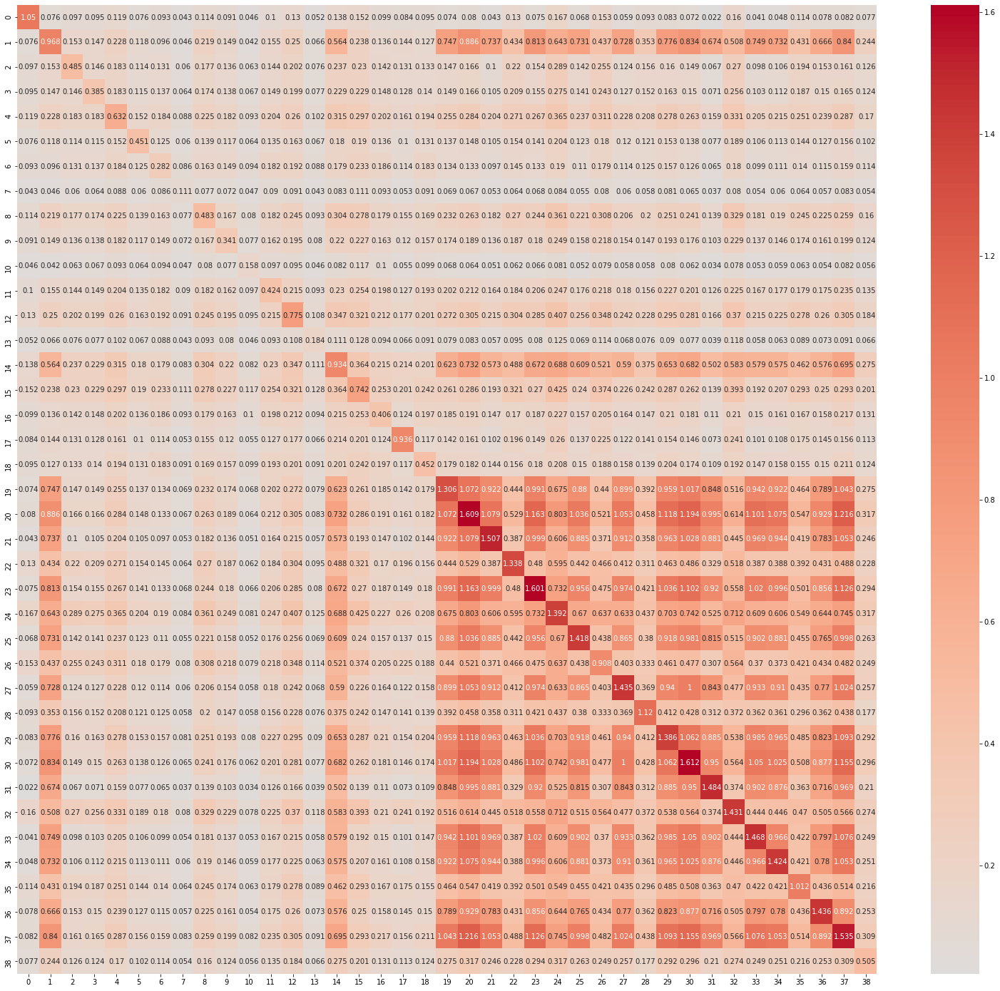

In [ ]:
plt.figure(figsize=(27,25))
sns.heatmap(np.round(cov_L, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
# plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/Est_Cov.png', bbox_inches='tight')

##### generation of correlation matrix

In [ ]:
print(df.index.values[-2], df.index.values[-P*P - 1])

cor_L[39,39] cor_L[1,1]


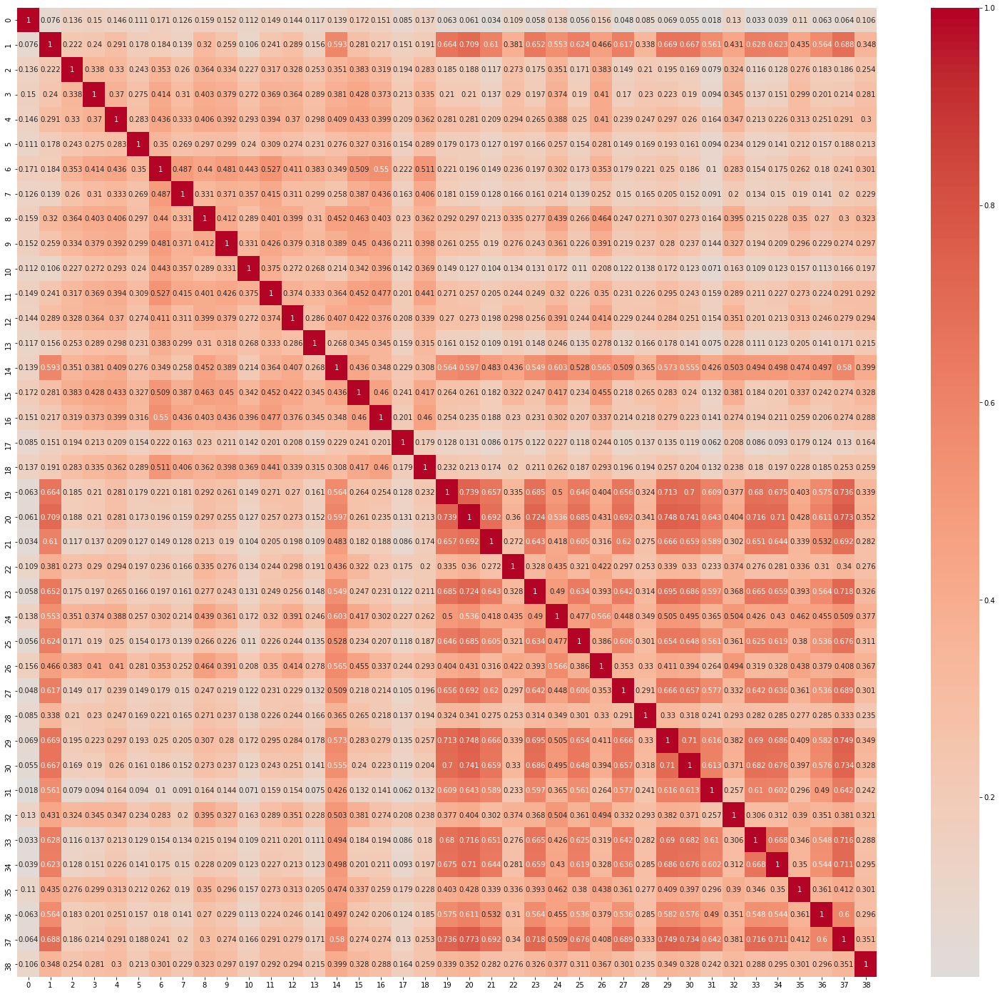

In [ ]:
cor_L = np.zeros(P*P)
for i,j in enumerate(df.index.values[df.index.get_loc("cor_L[1,1]"):df.index.get_loc("cor_L[39,39]")+1]):
  cor_L[i] = df['mean'][j]
cor_L = np.reshape(cor_L, (P, P), order = 'F')
plt.figure(figsize=(27,25))
sns.heatmap(np.round(cor_L, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
# plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/Est_Cor.png', bbox_inches='tight')

##### omega correlation matrix

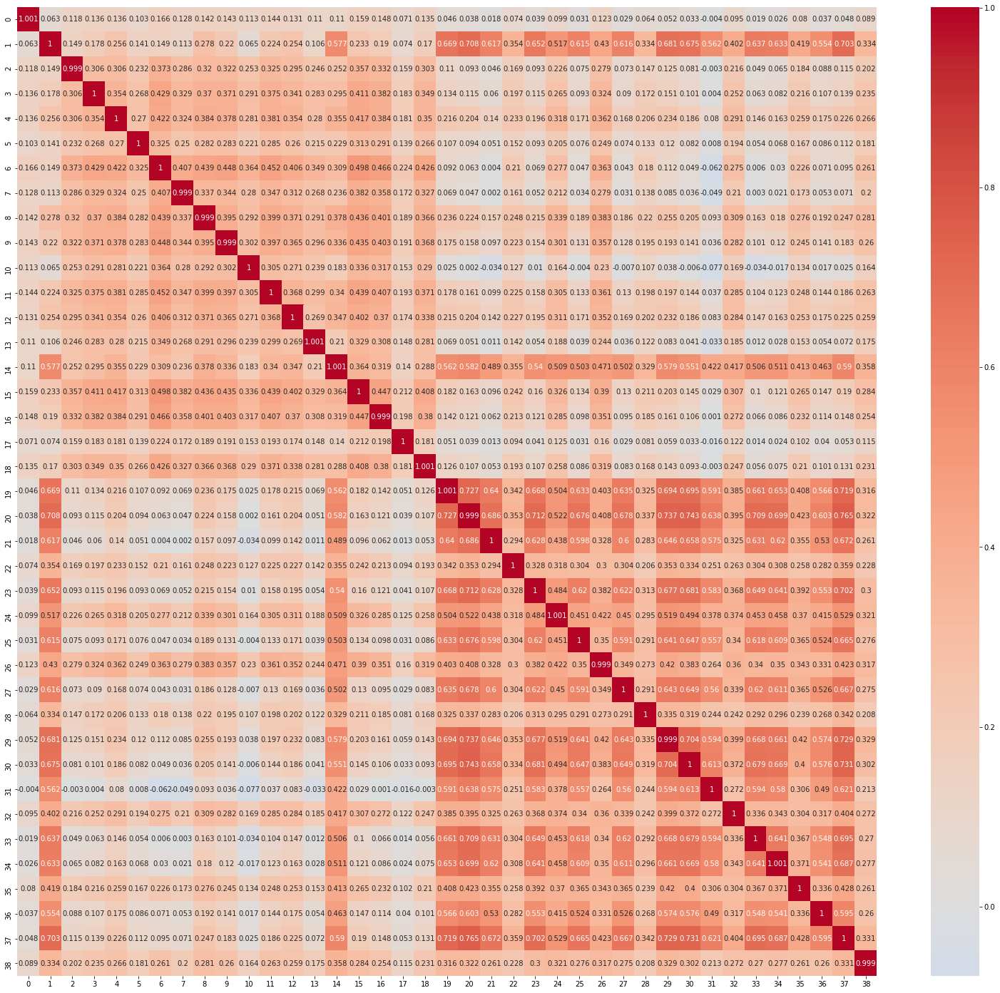

In [ ]:
plt.figure(figsize=(27,25))
sns.heatmap(np.round(omega_cov_L, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
# plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/Est_omega_Cor.png', bbox_inches='tight')

##### comparison of cor and cov matrices (AERRS)

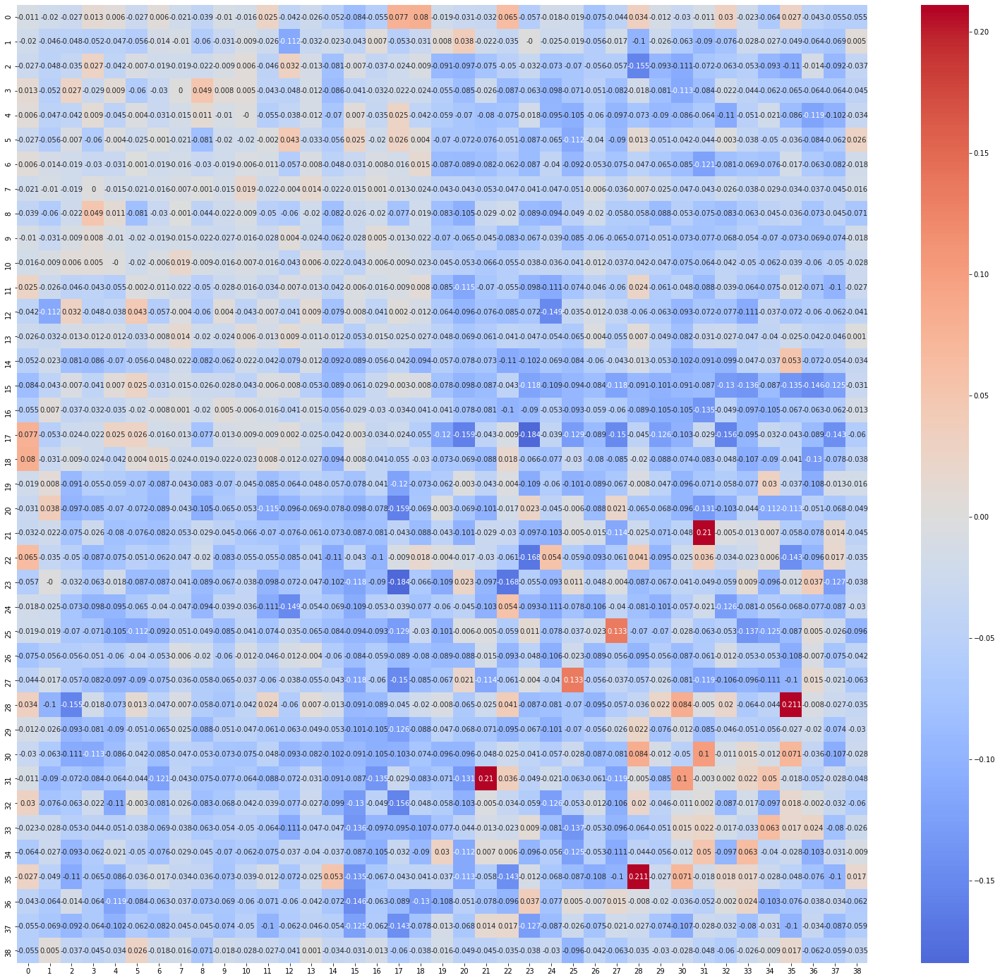

In [ ]:
plt.figure(figsize=(27,25))
sns.heatmap(np.round(cov_Y_sorted - cov_L, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
# plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/AERR_Cov.png', bbox_inches='tight')

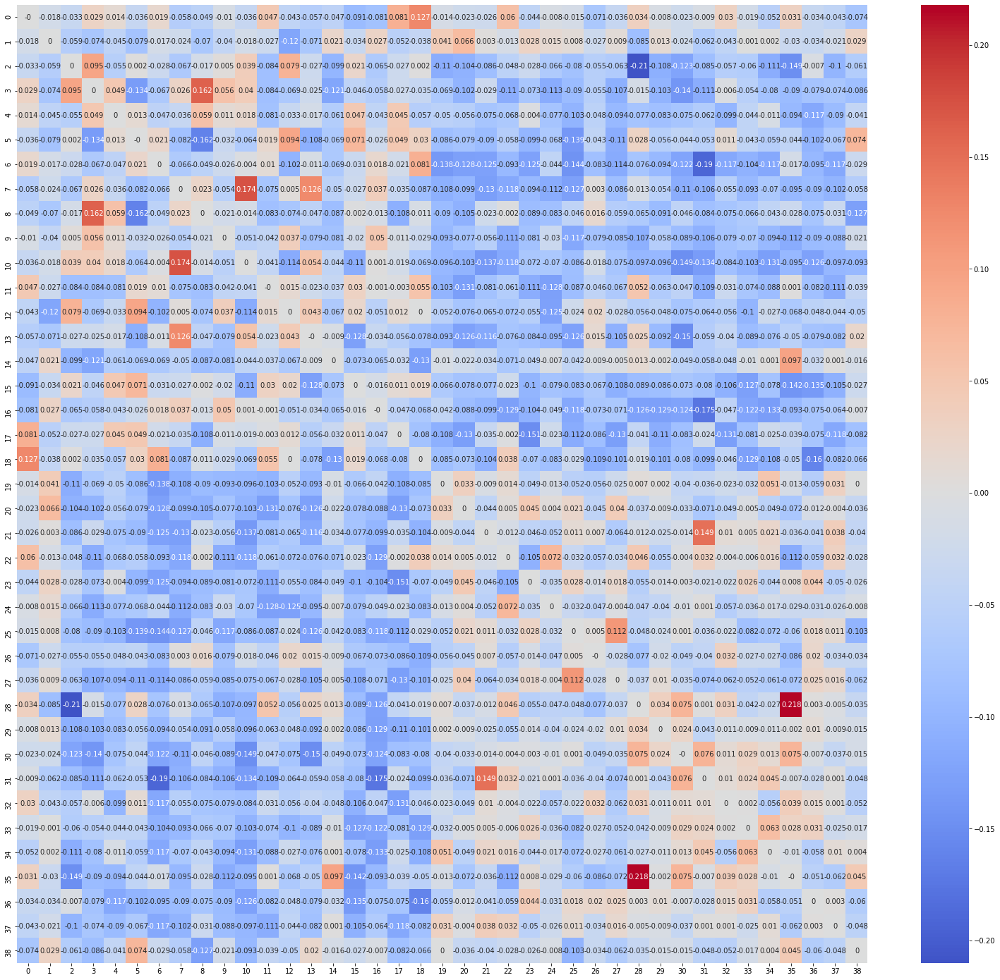

In [ ]:
plt.figure(figsize=(27,25))
sns.heatmap(np.round(C_Y_sorted - cor_L, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
# plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/AERR_Cor.png', bbox_inches='tight')

##### comparison of correlation matrix generated by omega results with true

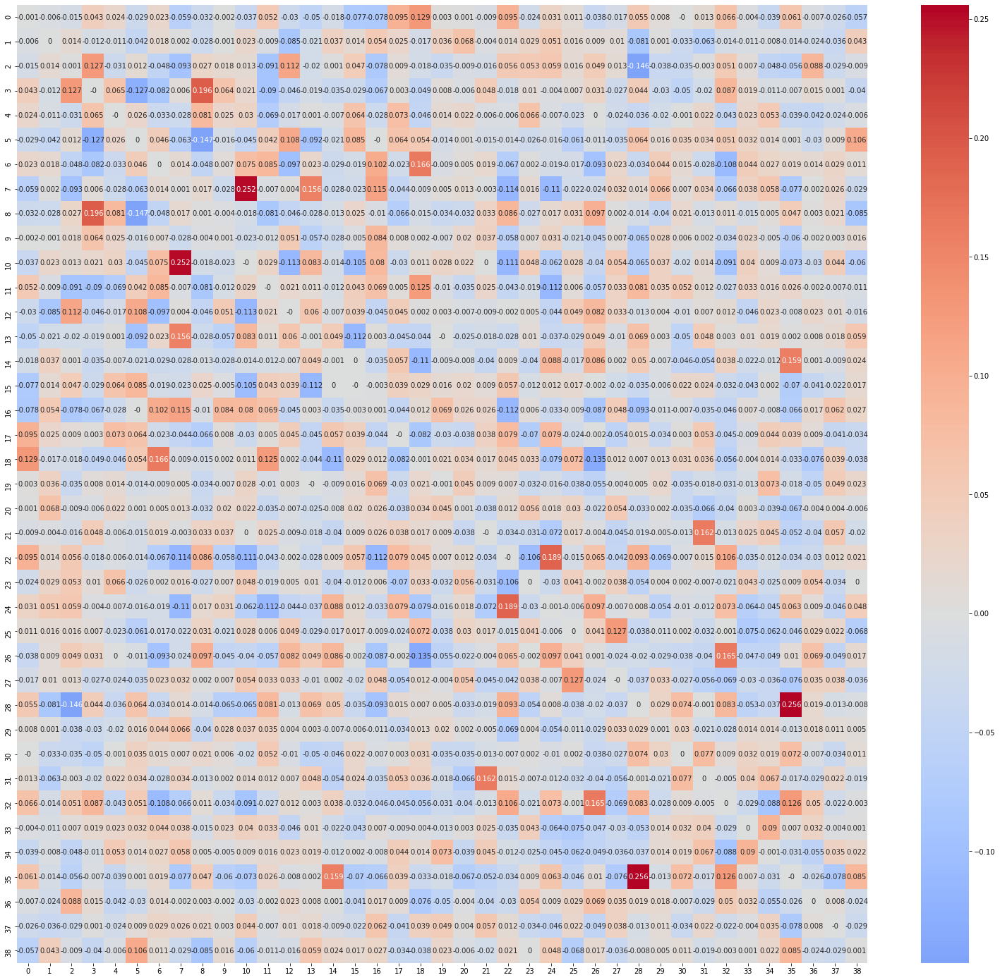

In [ ]:
plt.figure(figsize=(27,25))
sns.heatmap(np.round(C_Y_sorted - omega_cov_L, 3), annot=True, fmt='g', cmap='coolwarm', center = 0)
plt.savefig(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/AERR_omega_Cor.png', bbox_inches='tight')

##### save

In [ ]:
# L_full_df.to_csv(r'drive/MyDrive/Colab Notebooks/lab_rotation/notebooks/saved_objects/lab_report/real/est_df_MASQ.csv')

##### Trace plots

In [ ]:
def trace_plot(Nchains, param, param_name='parameter'):
  ''' param in shape (total samples (:), row of L matrix, col of L matrix) 
      returns trace plot of each chain in parallel
  '''
  param = param.reshape(int(param.shape[0]/Nchains), Nchains) 
  # Summary statistics
  mean = np.mean(param)
  median = np.median(param)
  cred_min, cred_max = np.percentile(param, 2.5), np.percentile(param, 97.5)
  # Plotting
  plt.figure(figsize=((15,3)))
  for i in range(Nchains):
    plt.plot(param[:, i], label = 'Chain {}'.format(i+1))
  plt.xlabel('samples')
  plt.ylabel(r'$\widehat{W}$'+ param_name)
  plt.axhline(mean, color='r', lw=2, linestyle='--',label='mean')
  plt.axhline(median, color='c', lw=2, linestyle='--',label='median')
  plt.axhline(cred_min, linestyle=':', color='k', alpha=0.2)
  plt.axhline(cred_max, linestyle=':', color='k', alpha=0.2)
  # plt.title('Trace for {}'.format(param_name))
  
  plt.gcf().tight_layout()
  plt.legend(loc = "lower left")

In [ ]:
L_all = fit['L']
L_all.shape

(1200, 39, 2)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until exp

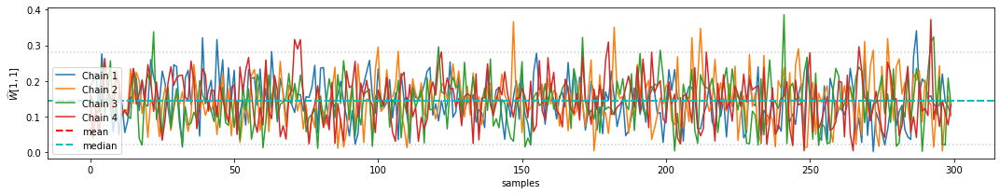

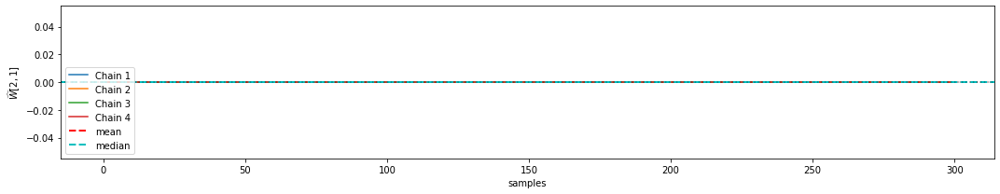

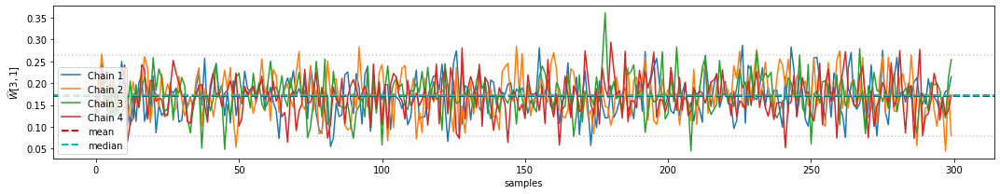

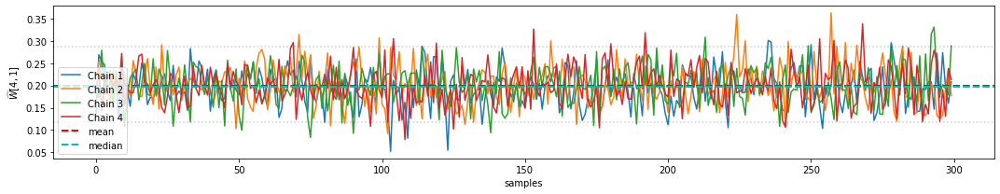

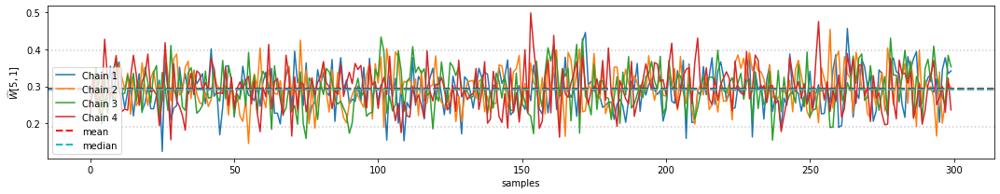

...

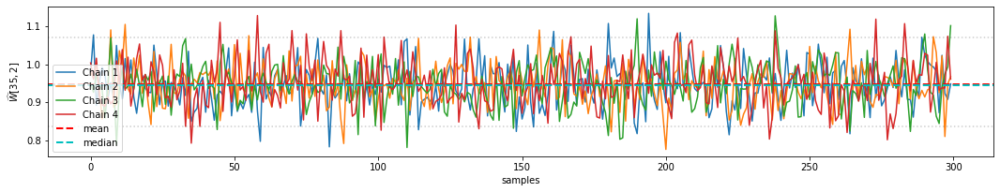

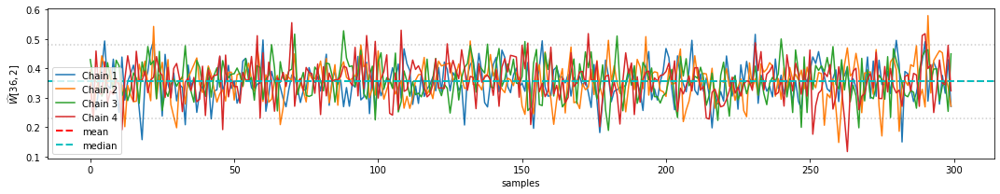

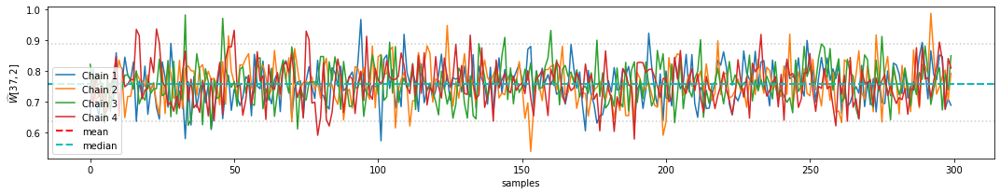

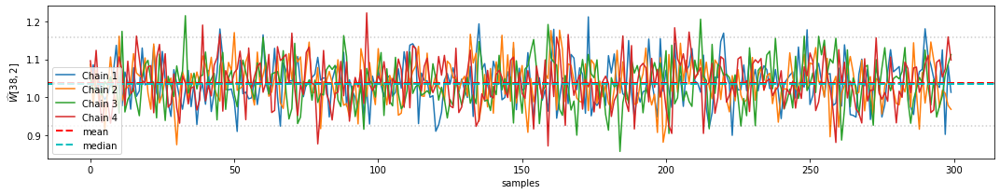

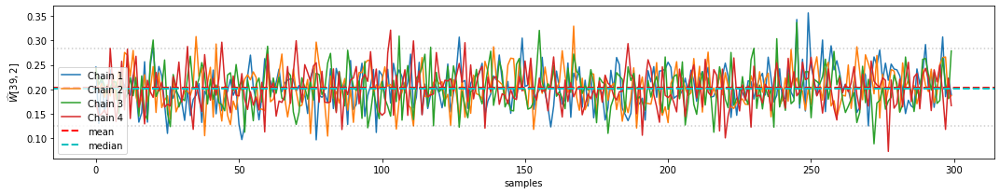

In [ ]:
for j in range(F):
  for i in range(P):
    trace_plot(4, L_all[:, i, j], r'$[{},{}]$'.format(i+1, j+1))

In [ ]:
L_G_all = fit['L_G']
L_G_all.shape

(1200, 39)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until exp

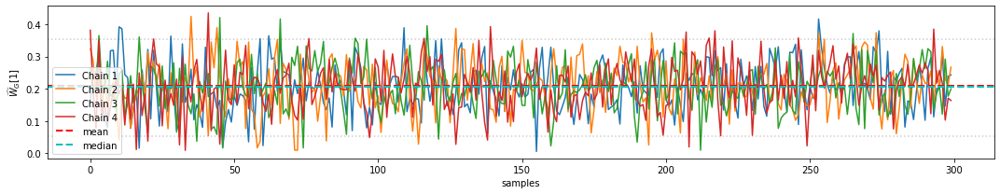

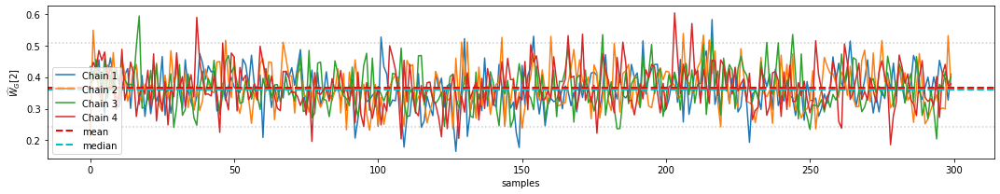

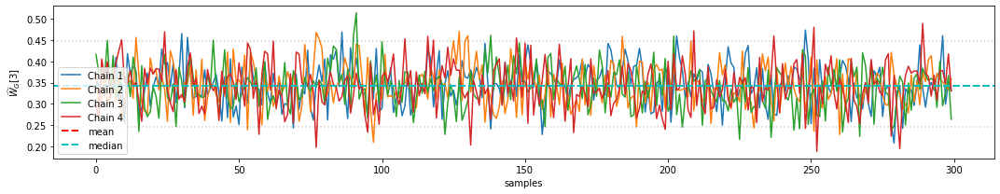

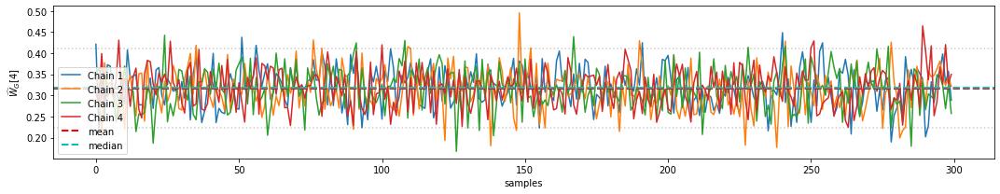

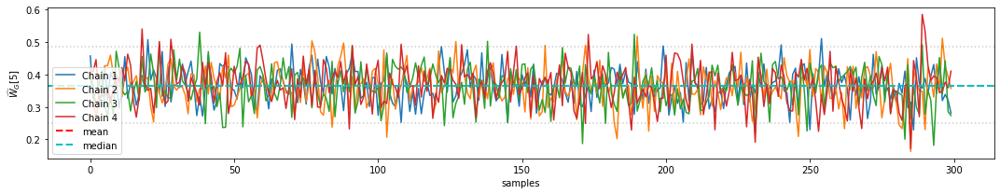

...

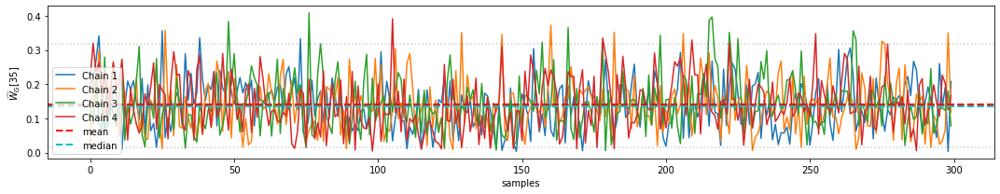

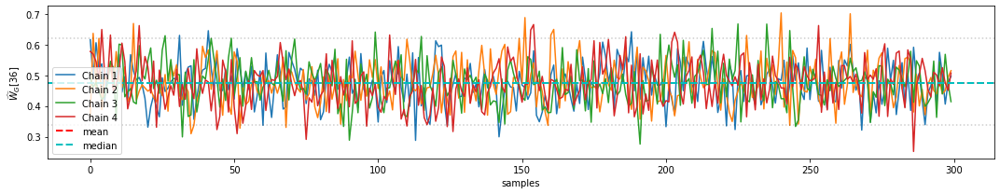

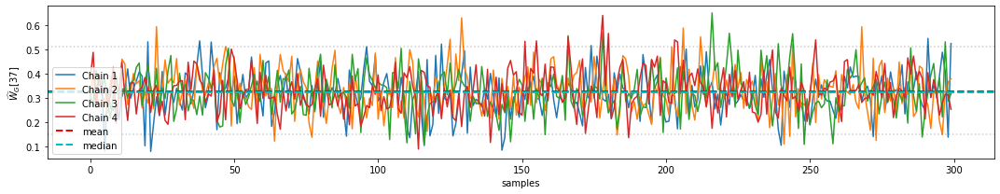

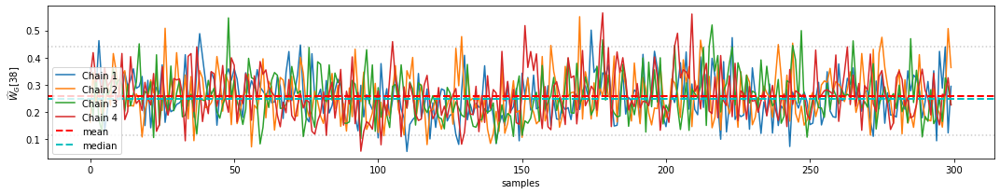

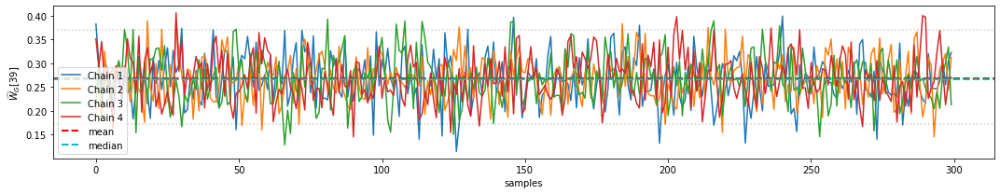

In [ ]:
for j in range(P):
  trace_plot(4, L_G_all[:, j], r'$_G[{}]$'.format(1+j))

In [ ]:
Psi_all = fit['psi']
Psi_all.shape

(1200, 39)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until exp

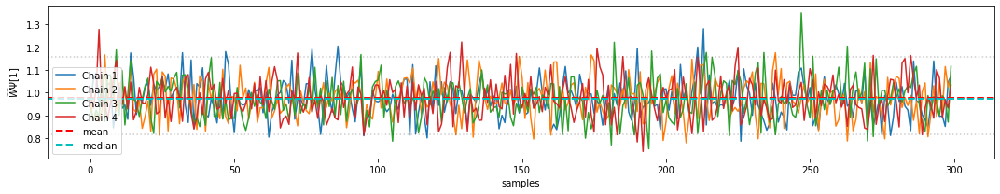

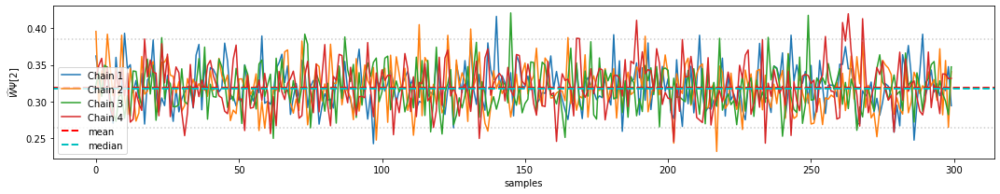

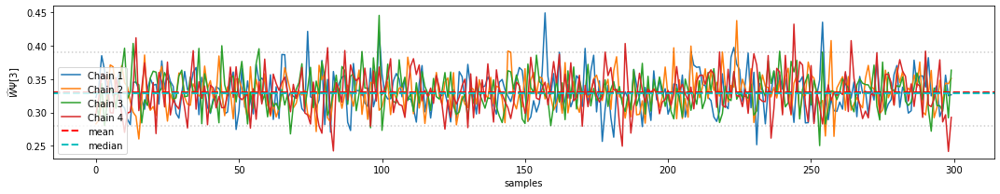

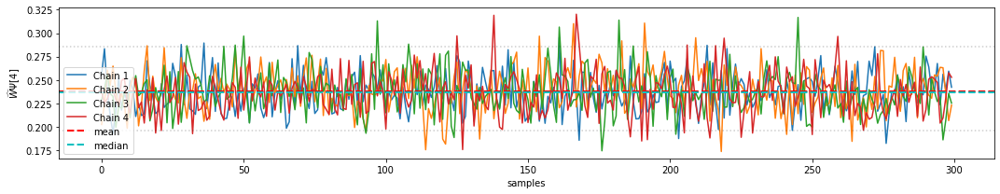

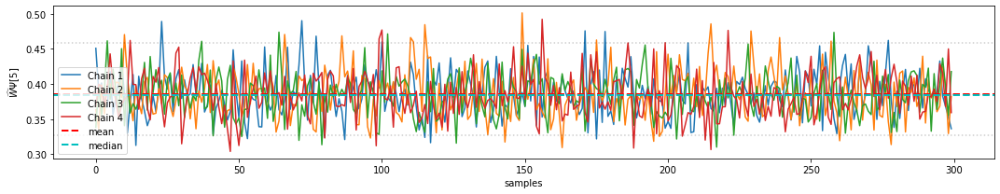

...

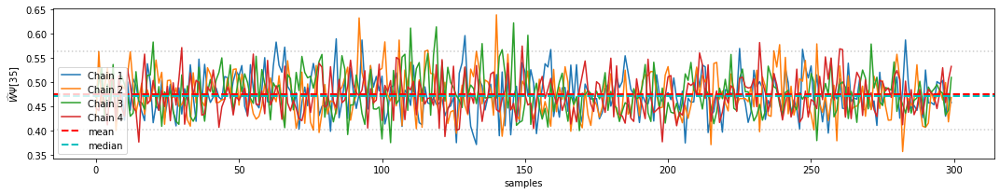

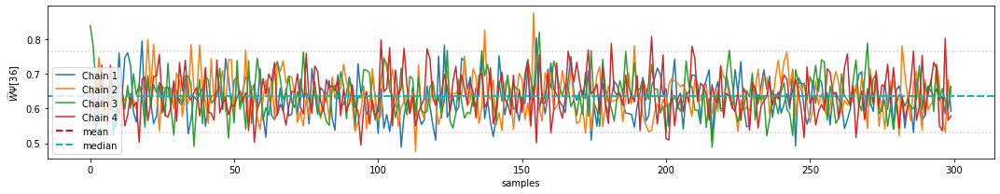

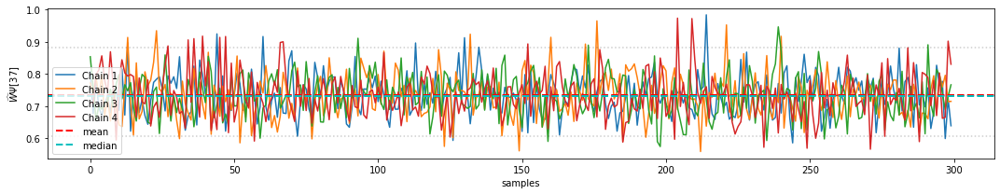

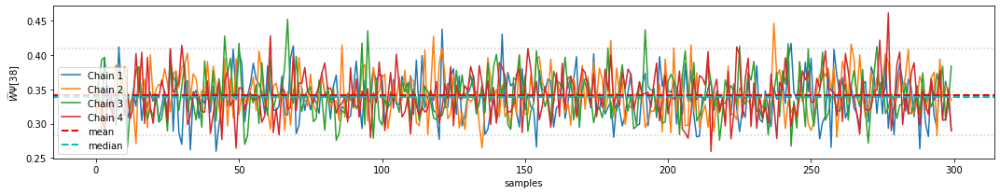

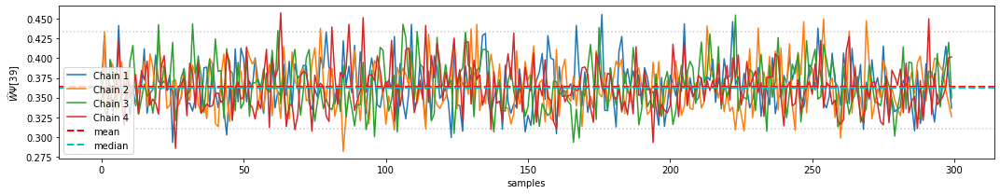

In [ ]:
for j in range(P):
  trace_plot(4, Psi_all[:, j], r'$\Psi[{}]$'.format(1+j))

##### posterior

In [ ]:
def posterior(Nchains, param, param_name='parameter'):
  ''' param_real in shape (row of L matrix, col of L matrix)
      param in shape (total samples (:), row of L matrix, col of L matrix) 
      returns trace plot of each chain in parallel
  '''
  param = param.reshape(int(param.shape[0]/Nchains), Nchains) 
  # Summary statistics
  mean = np.mean(param)
  median = np.median(param)
  cred_min, cred_max = np.percentile(param, 2.5), np.percentile(param, 97.5)
  # Plotting
  plt.figure(figsize=((5,5)))

  for i in range(Nchains):
    plt.hist(param[:,i], 30, density=True); sns.kdeplot(param[:,i], shade=True)
  plt.xlabel(r'$\widehat{W}$'+ param_name)
  plt.ylabel(r'$Density \ of \ \widehat{W}$'+ param_name)
  plt.axvline(mean, color='r', lw=2, linestyle='--',label='mean')
  plt.axvline(median, color='c', lw=2, linestyle='--',label='median')
  plt.axvline(cred_min, linestyle=':', color='k', alpha=0.2, label='95% CI')
  plt.axvline(cred_max, linestyle=':', color='k', alpha=0.2)
  
  plt.gcf().tight_layout()
  plt.legend(loc = "lower left")

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

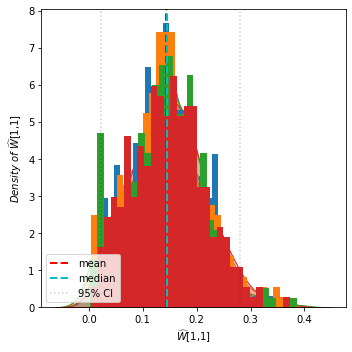

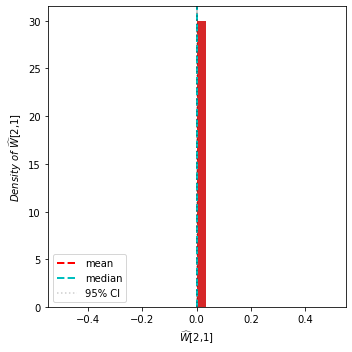

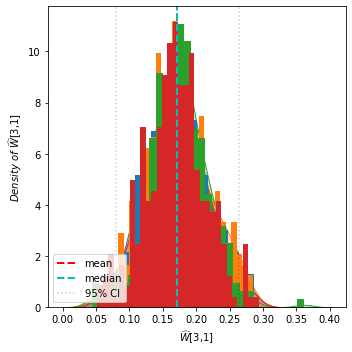

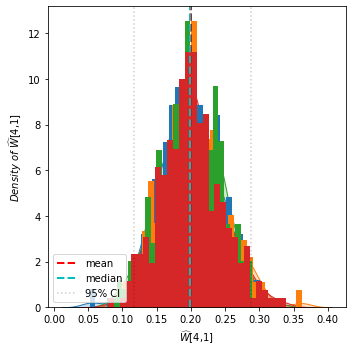

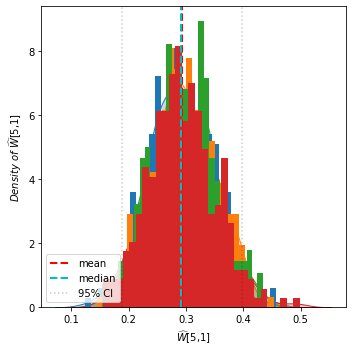

...

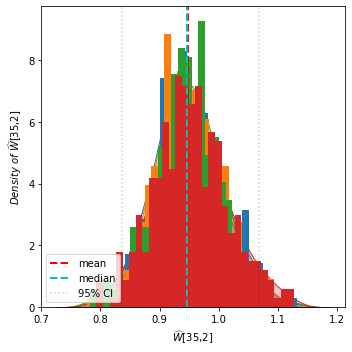

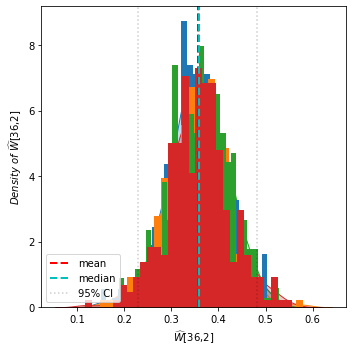

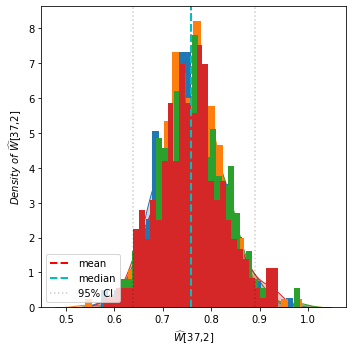

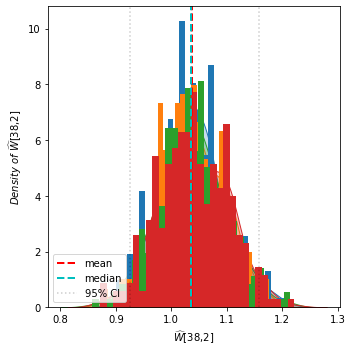

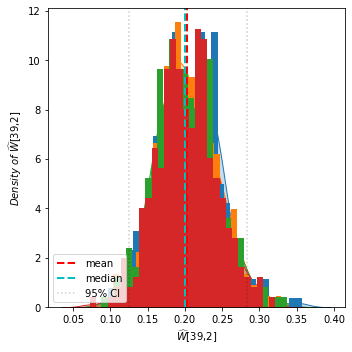

In [ ]:
for j in range(F):
  for i in range(P):
    posterior(4, L_all[:, i, j], '[{},{}]'.format(1+i, 1+j))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this war

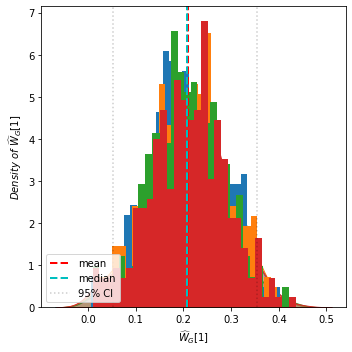

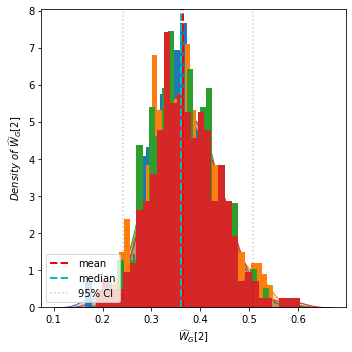

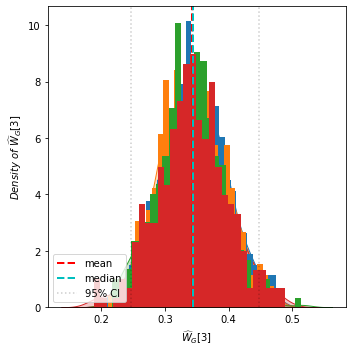

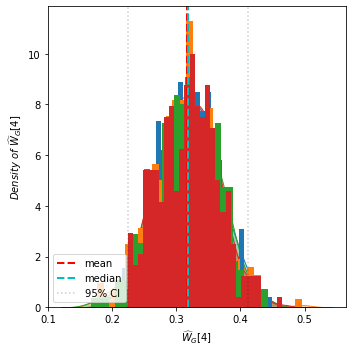

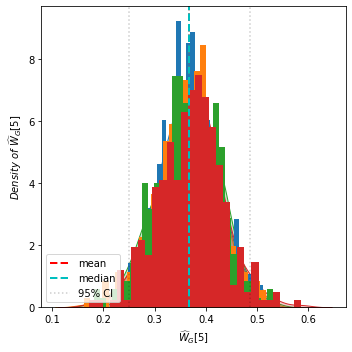

...

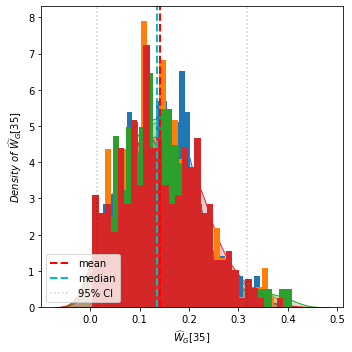

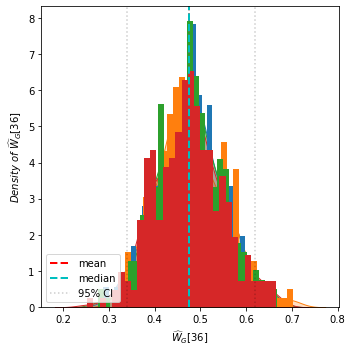

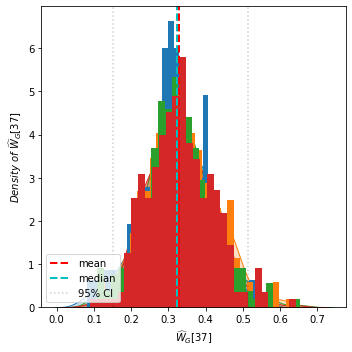

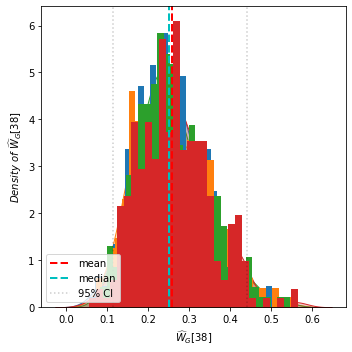

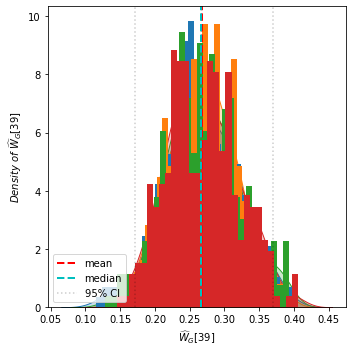

In [ ]:
for j in range(P):
  posterior(4, L_G_all[:, j], r'$_G[{}]$'.format(j+1))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this war

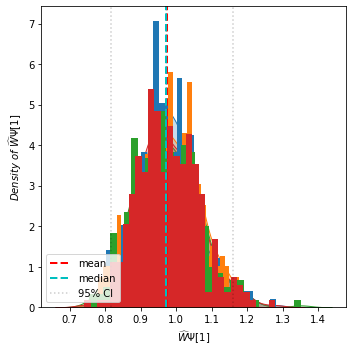

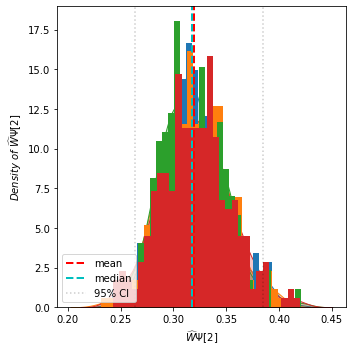

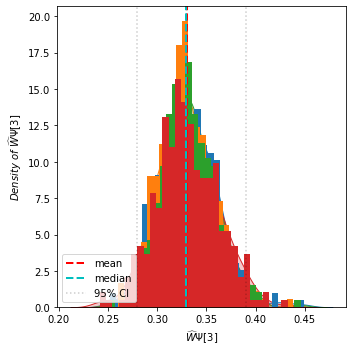

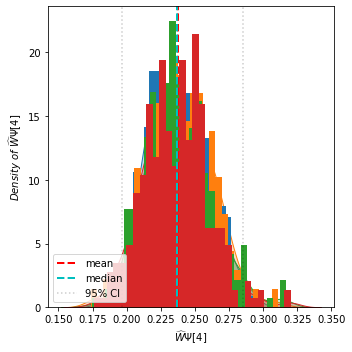

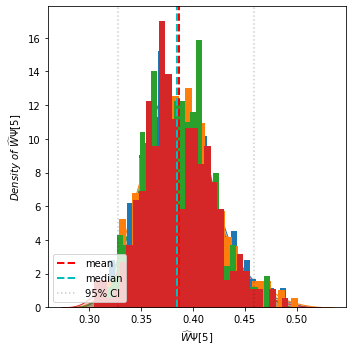

...

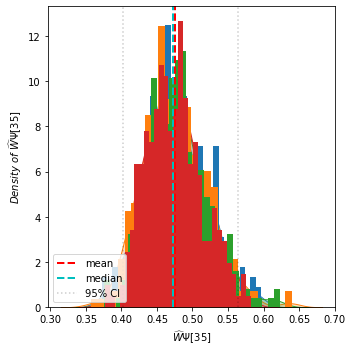

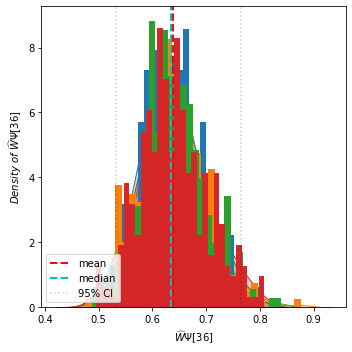

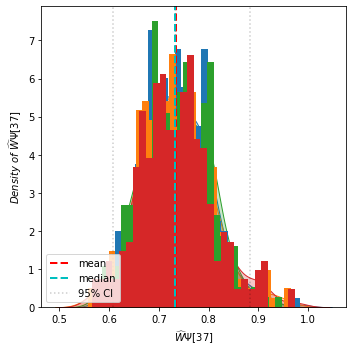

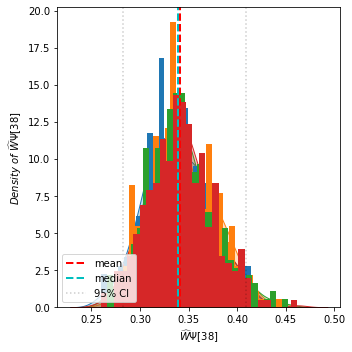

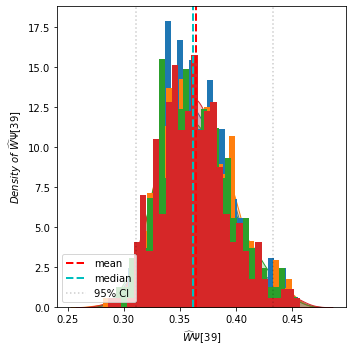

In [ ]:
for j in range(P):
  posterior(4, Psi_all[:, j], r'$\Psi[{}]$'.format(1+j))